In [1]:
# Import the data and label coordinates



# Create label maps from the coordinates



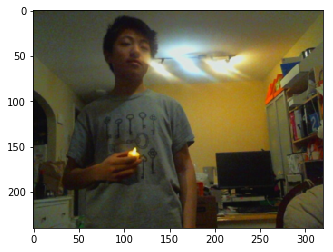

In [7]:
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import models, transforms

loader = transforms.Compose([
  transforms.Resize((240,320)),
  #transforms.CenterCrop(img_size),
  transforms.ToTensor(),
]) 

def load_image(filename, volatile=False):
    """
    Simple function to load and preprocess the image.

    1. Open the image.
    2. Scale/crop it and convert it to a float tensor.
    3. Convert it to a variable (all inputs to PyTorch models must be variables).
    4. Add another dimension to the start of the Tensor (b/c VGG expects a batch).
    5. Move the variable onto the GPU.
    """
    image = Image.open(filename).convert('RGB')
    image_tensor = loader(image).float()
    return image_tensor
    #image_var = Variable(image_tensor, volatile=volatile).unsqueeze(0)
    #return image_var.cuda

plt.imshow(load_image('data/fk_cndls/left/32.jpg').numpy().transpose(1,2,0))

In [8]:
import torch
import torch.nn.functional as F
from torch import nn
CPU_DEBUG = False

# Setup the model
%env CUDA_LAUNCH_BLOCKING=1
device = torch.device("cpu" if CPU_DEBUG else "cuda")

class CoarseFireDetector(nn.Module):
    # Your code goes here
    def __init__(self):
        super(CoarseFireDetector, self).__init__()
        self.layers = nn.ModuleList([nn.Conv2d(3, 64, 5, bias=True, padding=2)])
        self.layers.append(nn.ReLU())
        self.layers.append(nn.Conv2d(64, 64, 5, stride=2, bias=True, padding=2))
        self.layers.append(nn.ReLU())
        self.layers.append(nn.Conv2d(64, 32, 5, stride=1, bias=True, padding=2))
        self.layers.append(nn.ReLU())
        self.layers.append(nn.Conv2d(32, 16, 5, stride=1, bias=True, padding=2))
        self.layers.append(nn.ReLU())
        self.layers.append(nn.Conv2d(16, 8, 3, stride=1, bias=True, padding=1))
        self.layers.append(nn.ReLU())
        self.layers.append(nn.Conv2d(8, 1, 3, stride=1, bias=True, padding=1))
        #self.layers.append(nn.Sigmoid())
    
    def forward(self, input):
        out = input 
        print(input.dim())
        if input.dim() == 3:
            out = out.unsqueeze(0)
            for layer in self.layers:
                out = layer(out)
            return out.squeeze()
        else:
            for layer in self.layers:
                out = layer(out)
            return out 
    

env: CUDA_LAUNCH_BLOCKING=1


3
torch.Size([120, 160])


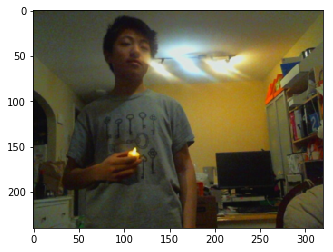

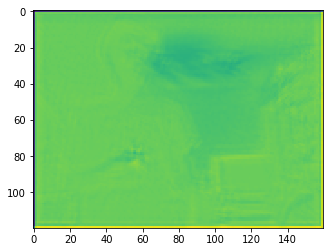

(120, 160)


In [9]:
cf_detector = CoarseFireDetector().cuda()
out = cf_detector(load_image('data/fk_cndls/left/32.jpg').cuda())
print(out.size())
plt.imshow(load_image('data/fk_cndls/left/32.jpg').numpy().transpose(1,2,0))
plt.show()
plt.imshow(out.cpu().detach().numpy())
plt.show()
print(out.cpu().detach().numpy().shape)
label_shape = out.cpu().detach().numpy().shape

In [10]:
import os
import pickle
import pprint

def show_torch_img(tensor):
    plt.imshow(tensor.detach().cpu().numpy().transpose(1,2,0))
    #plt.show()

pp = pprint.PrettyPrinter(indent=2)

# Training Dataset
data = "data/nir_cndls"
metadp = "metadata.dat"
metadata = None
with open(os.path.join(data, metadp), 'rb') as metadf:
    metadata = pickle.load(metadf)
    pp.pprint(metadata)
    metadata = dict((k,metadata[k]) for k in range(0, 34))

# load the input imgs
input_imgs = []
coords = []
for i, num in enumerate(metadata):
    input_imgs.append(load_image(metadata[num]['left']['img_path']))
    coords.append(metadata[num]['left']['coords'])
    input_imgs.append(load_image(metadata[num]['right']['img_path']))
    coords.append(metadata[num]['right']['coords'])
    #print(coords[-2])
    #show_torch_img(input_imgs[-2])
    #show_torch_img(input_imgs[-1])

{ 0: { 'left': { 'coords': {0: (140, 129)},
                 'img_path': './data/fk_cndls/left/0.jpg'},
       'right': { 'coords': {0: (495, 147)},
                  'img_path': './data/fk_cndls/right/0.jpg'}},
  1: { 'left': { 'coords': {0: (173, 251)},
                 'img_path': './data/fk_cndls/left/1.jpg'},
       'right': { 'coords': {0: (407, 266)},
                  'img_path': './data/fk_cndls/right/1.jpg'}},
  2: { 'left': { 'coords': {0: (85, 125)},
                 'img_path': './data/fk_cndls/left/2.jpg'},
       'right': { 'coords': {0: (370, 142)},
                  'img_path': './data/fk_cndls/right/2.jpg'}},
  3: { 'left': { 'coords': {0: (160, 336)},
                 'img_path': './data/fk_cndls/left/3.jpg'},
       'right': { 'coords': {0: (270, 351)},
                  'img_path': './data/fk_cndls/right/3.jpg'}},
  4: { 'left': { 'coords': {0: (233, 391)},
                 'img_path': './data/fk_cndls/left/4.jpg'},
       'right': { 'coords': {0: (376, 404)},
    

2D Gaussian-like array:
[[1.49453385e-05 4.29464934e-05 1.10431945e-04 2.54101243e-04
  5.23195397e-04 9.63975726e-04 1.58932728e-03 2.34479909e-03
  3.09558685e-03 3.65700376e-03 3.86592014e-03 3.65700376e-03
  3.09558685e-03 2.34479909e-03 1.58932728e-03 9.63975726e-04
  5.23195397e-04 2.54101243e-04 1.10431945e-04 4.29464934e-05
  1.49453385e-05]
 [4.29464934e-05 1.23409804e-04 3.17334049e-04 7.30177997e-04
  1.50343919e-03 2.77005282e-03 4.56704501e-03 6.73794700e-03
  8.89538904e-03 1.05086605e-02 1.11089965e-02 1.05086605e-02
  8.89538904e-03 6.73794700e-03 4.56704501e-03 2.77005282e-03
  1.50343919e-03 7.30177997e-04 3.17334049e-04 1.23409804e-04
  4.29464934e-05]
 [1.10431945e-04 3.17334049e-04 8.15987835e-04 1.87756834e-03
  3.86592014e-03 7.12287072e-03 1.17436285e-02 1.73258520e-02
  2.28734649e-02 2.70218060e-02 2.85655008e-02 2.70218060e-02
  2.28734649e-02 1.73258520e-02 1.17436285e-02 7.12287072e-03
  3.86592014e-03 1.87756834e-03 8.15987835e-04 3.17334049e-04
  1.104319

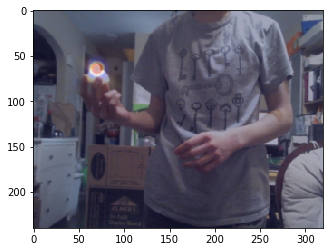

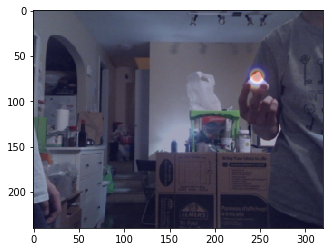

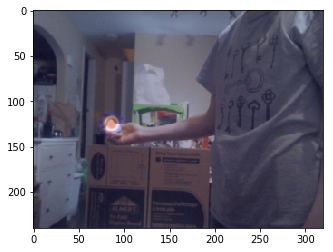

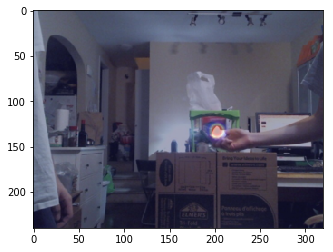

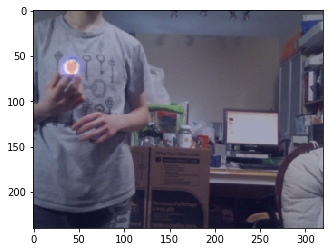

...

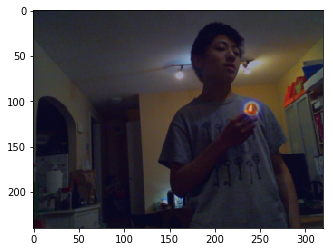

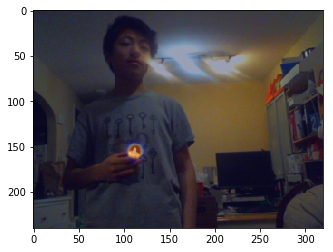

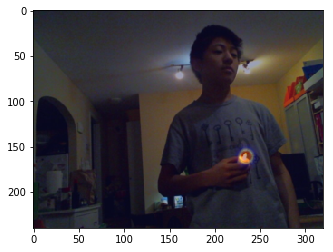

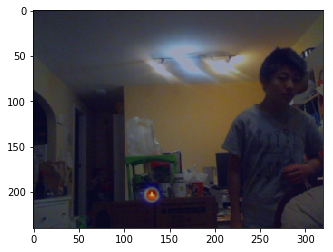

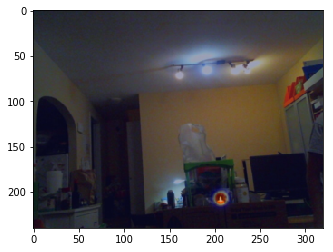

In [11]:
import numpy as np
from scipy import ndimage 
w = 21 
x, y = np.meshgrid(np.linspace(-1,1,w), np.linspace(-1,1,w))
d = np.sqrt(x*x+y*y)
sigma, mu = 0.3, 0.0
g = np.exp(-( (d-mu)**2 / ( 2.0 * sigma**2 ) ) )
print("2D Gaussian-like array:")
print(g)
plt.imshow(g)
print(g.shape)

labels = []
for num, img in enumerate(input_imgs):
    #print(num)
    # Create labels
    #print(metadata[num])
    #print(input_imgs[num])
    label = np.zeros(label_shape)
    #print(coords[num])
    coord = coords[num][0]
    _, input_imgs_w, input_imgs_h = input_imgs[num].numpy().shape
    #print(input_imgs_w, input_imgs_h)
    #print(label_shape)
    #print(coord)
    central = (int(coord[1]/(2*input_imgs_w)*label_shape[0]), 
                    int(coord[0]/(2*input_imgs_h)*label_shape[1]))
    #print(central)
    #print(central)
    side = w // 2 
    for i in range(-side, side+1):
        for j in range(-side, side+1):
            #lx = min(max(central[1]+i, 0),label_shape[0]-1)
            #ly = min(max(central[0]+j, 0),label_shape[1]-1)
            lx = central[0]+i
            ly = central[1]+j
            if lx >= 0 and lx < label_shape[0] and ly >=0 and ly < label_shape[1]:
                label[lx, ly] += g[i+side, j+side] 
    show_torch_img(img)
    #plt.imshow(label)
    plt.imshow(ndimage.zoom(label, (input_imgs_w/label_shape[0], input_imgs_h/label_shape[1])), interpolation='nearest', cmap='seismic', alpha=0.3)
    plt.show()
    #show_torch_img
    labels.append(label)
 

tensor(0.4686, device='cuda:0')
4


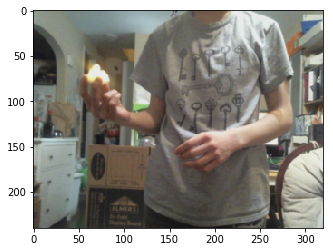

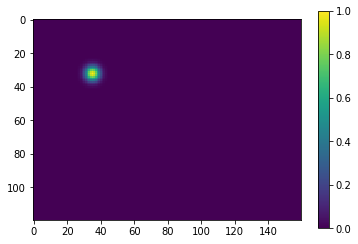

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


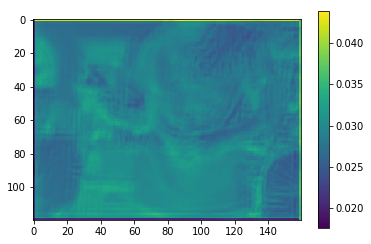

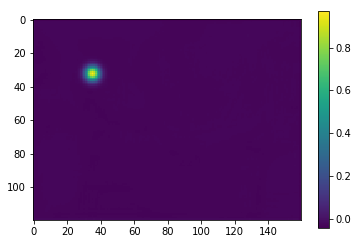

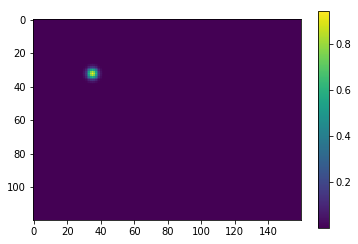

0.0019978582859039307
tensor(0.5000, device='cuda:0')
4


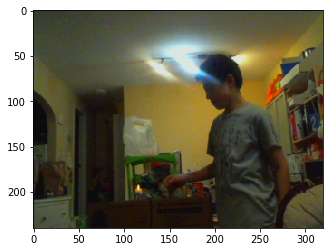

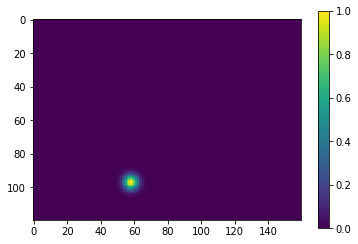

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


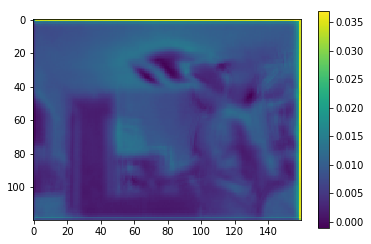

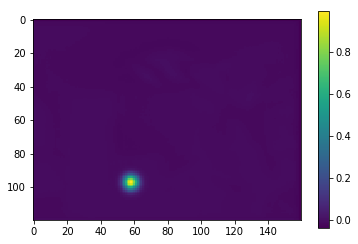

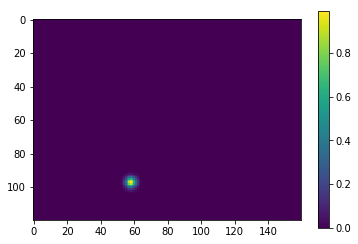

0.0017421283992007375
tensor(0.4922, device='cuda:0')
4


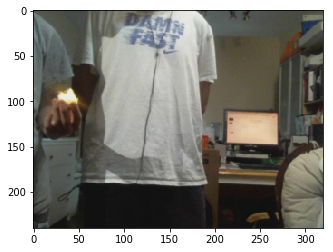

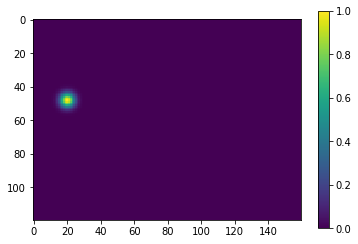

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


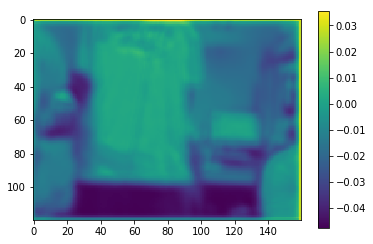

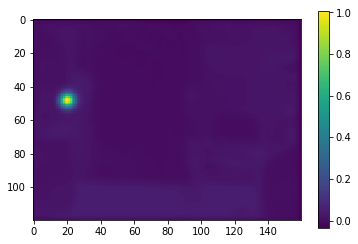

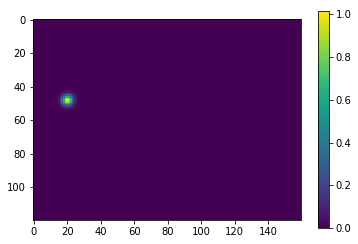

0.0022664708085358143
tensor(0.4686, device='cuda:0')
4


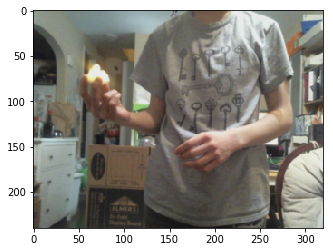

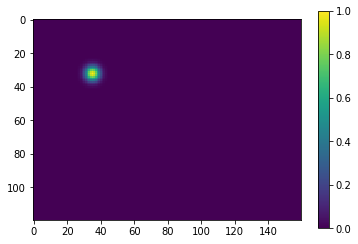

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


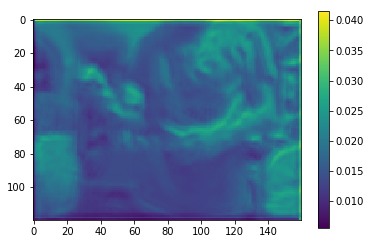

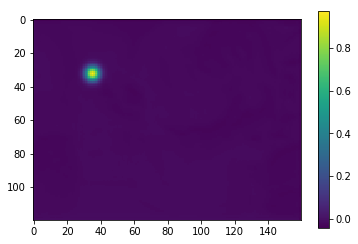

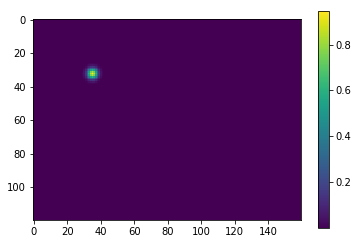

0.0017345965607091784
tensor(0.5000, device='cuda:0')
4


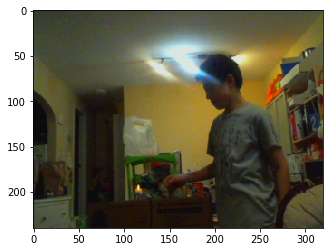

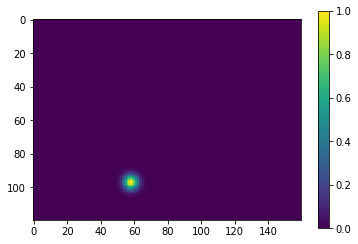

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


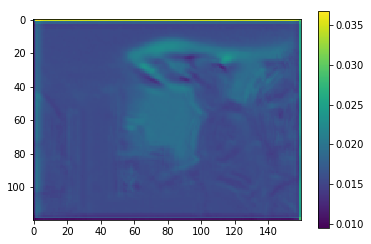

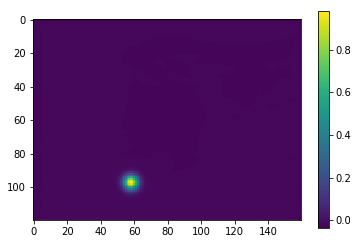

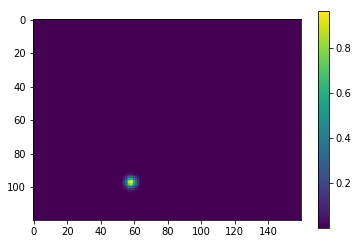

0.0017582214204594493
tensor(0.4922, device='cuda:0')
4


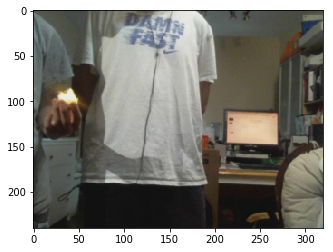

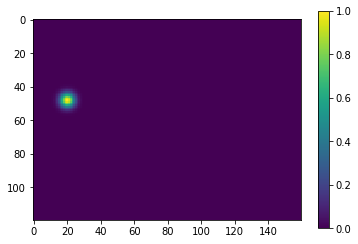

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


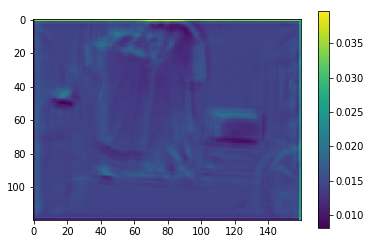

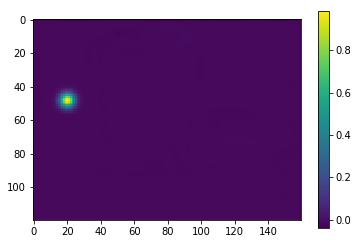

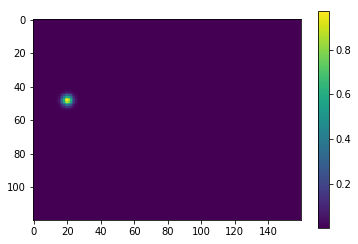

0.0017472195904701948
tensor(0.4686, device='cuda:0')
4


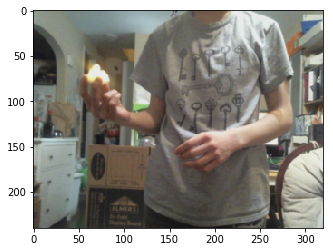

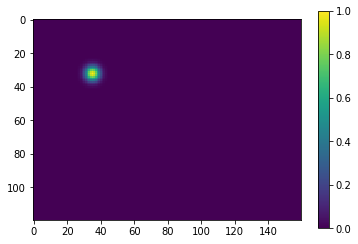

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


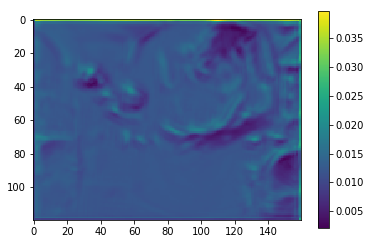

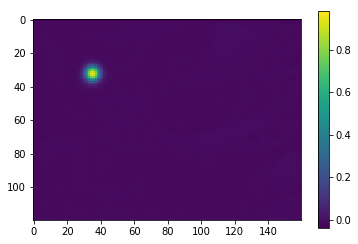

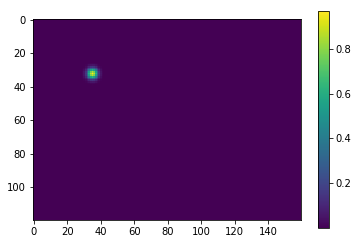

0.001727978466078639
tensor(0.5000, device='cuda:0')
4


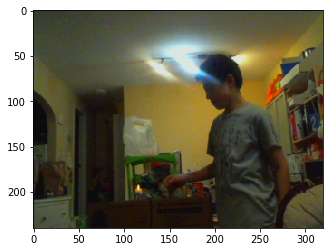

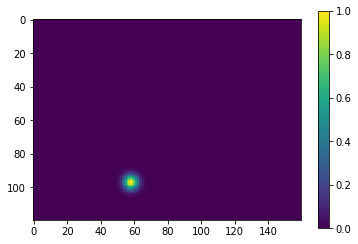

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


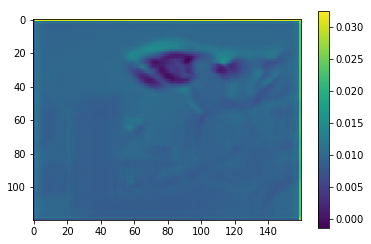

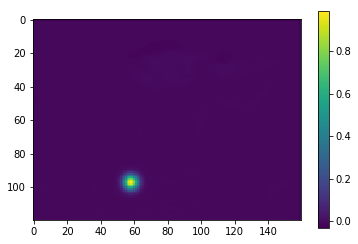

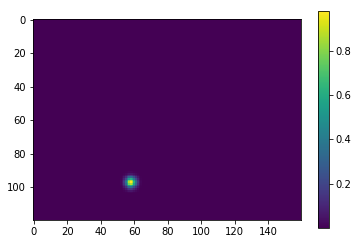

0.001710853772237897
tensor(0.4922, device='cuda:0')
4


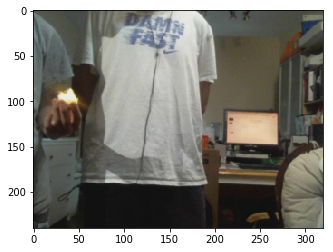

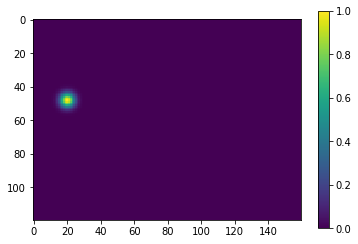

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


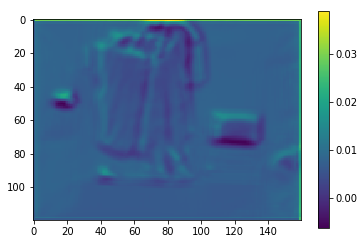

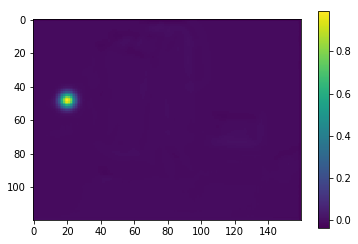

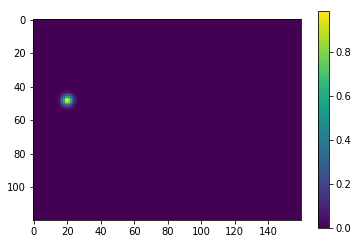

0.0017089640023186803
tensor(0.4686, device='cuda:0')
4


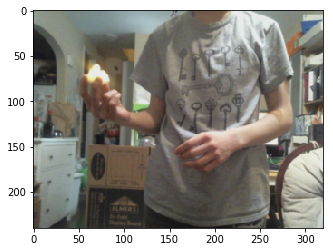

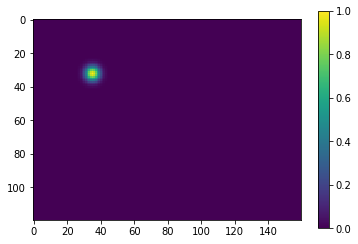

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


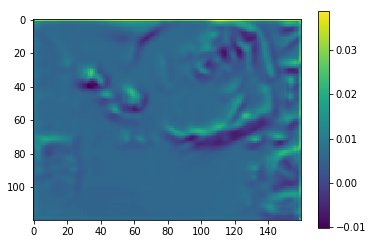

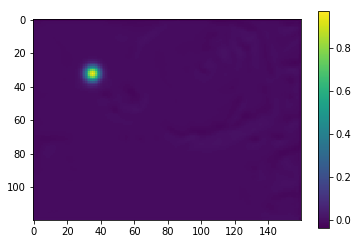

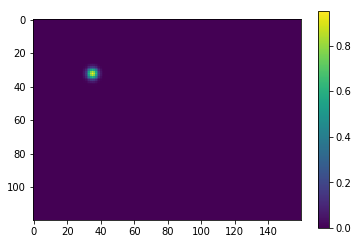

0.0016869533574208617
tensor(0.5000, device='cuda:0')
4


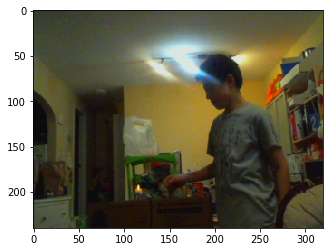

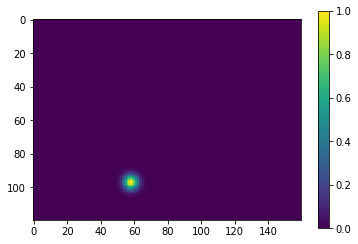

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


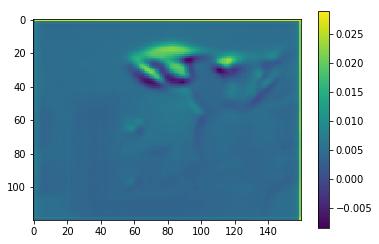

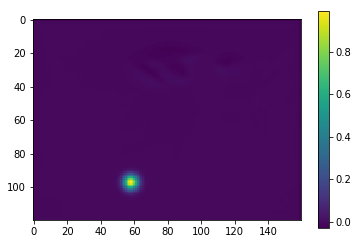

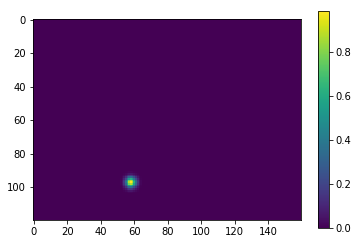

0.0016761530423536897
tensor(0.4922, device='cuda:0')
4


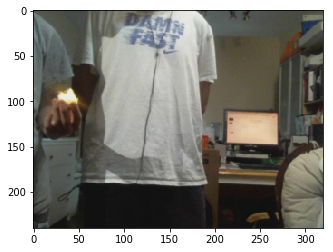

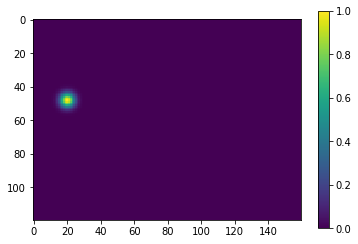

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


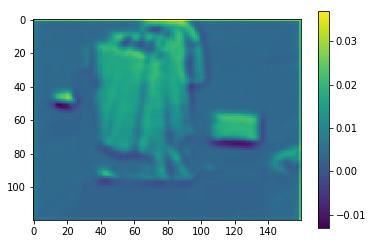

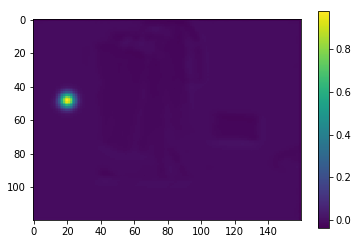

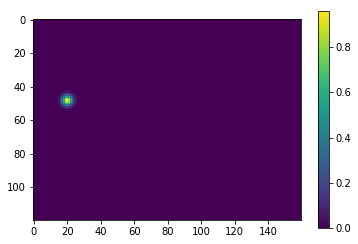

0.0016889084363356233
tensor(0.4686, device='cuda:0')
4


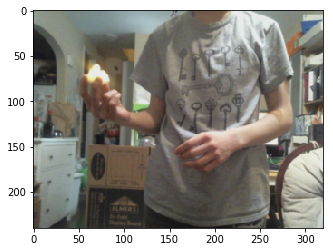

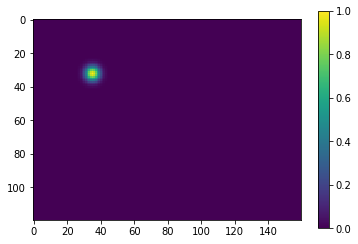

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


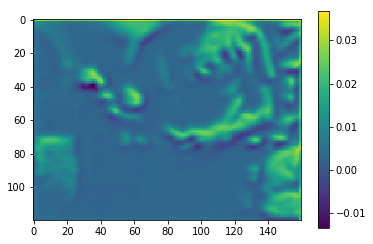

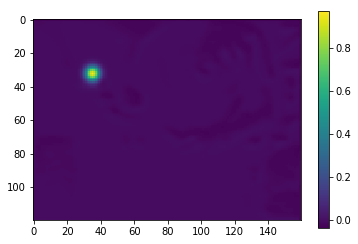

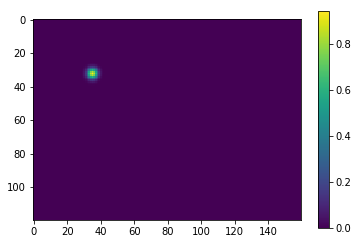

0.0016636706423014402
tensor(0.5000, device='cuda:0')
4


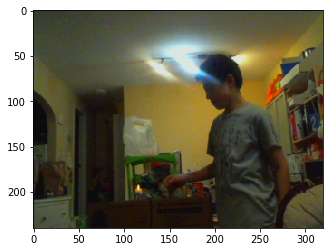

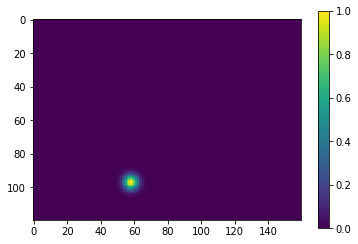

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


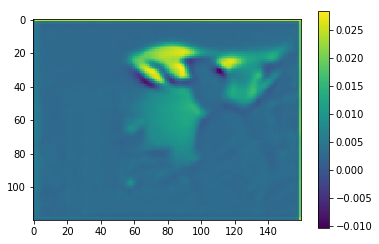

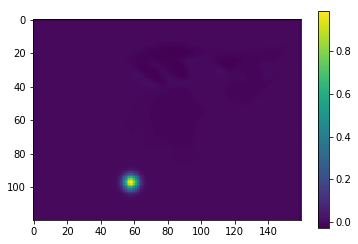

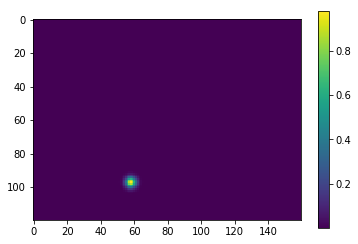

0.001660925685428083
tensor(0.4922, device='cuda:0')
4


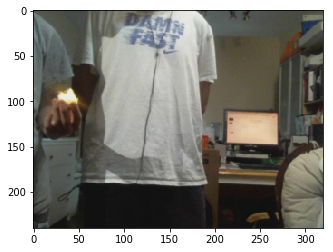

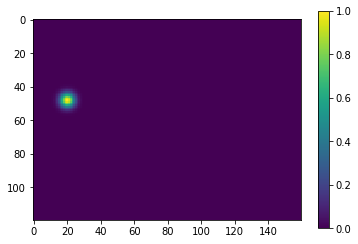

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


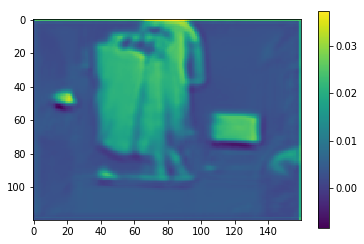

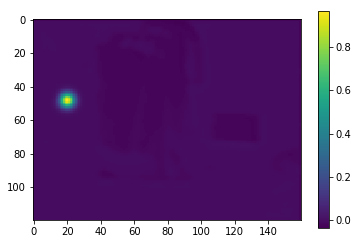

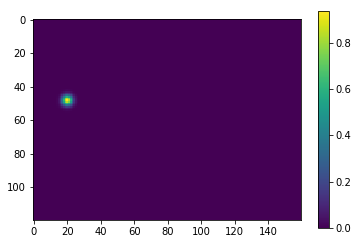

0.0016658550594002008
tensor(0.4686, device='cuda:0')
4


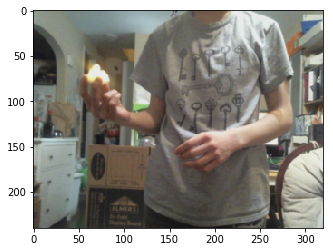

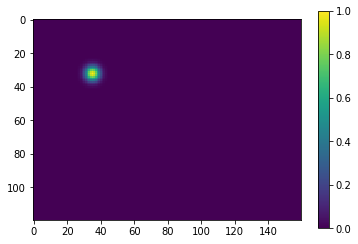

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


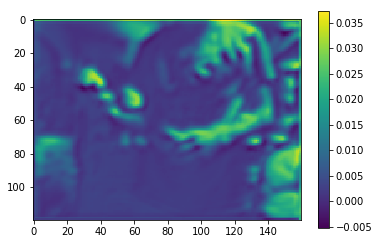

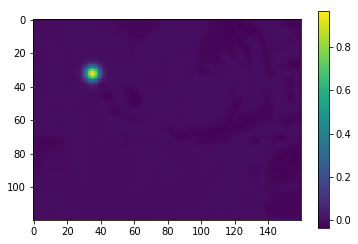

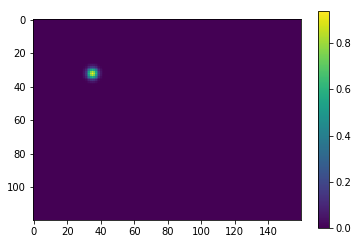

0.0016506543615832925
tensor(0.5000, device='cuda:0')
4


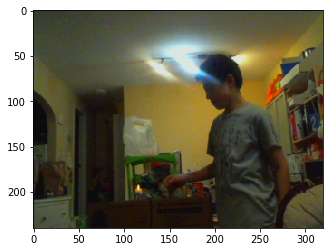

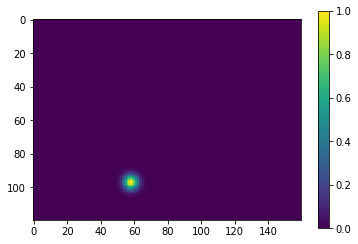

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


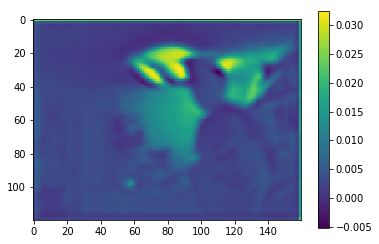

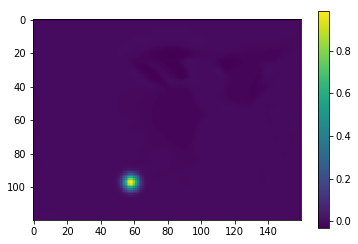

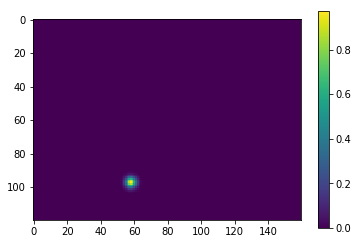

0.001643143710680306
tensor(0.4922, device='cuda:0')
4


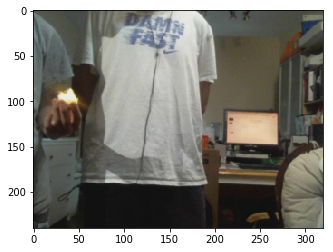

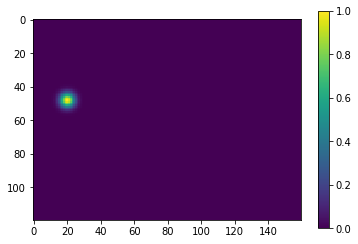

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


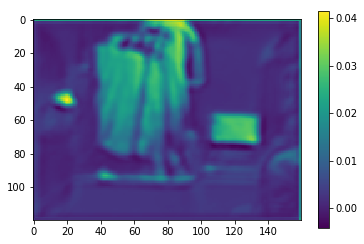

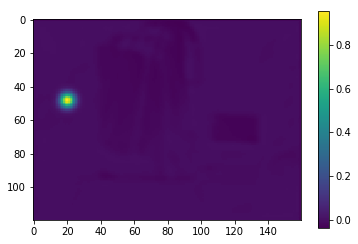

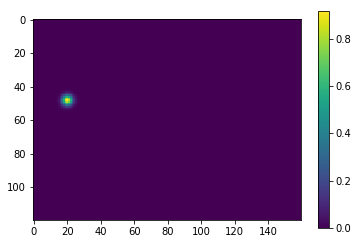

0.0016341034788638353
tensor(0.4686, device='cuda:0')
4


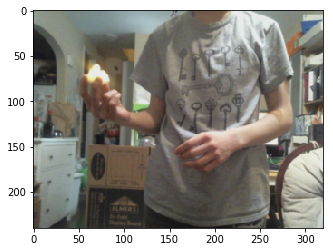

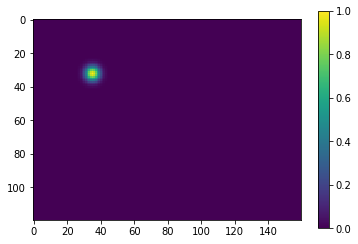

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


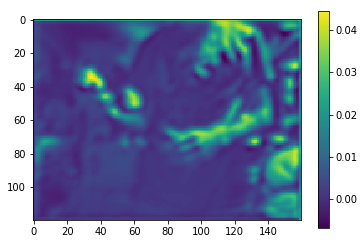

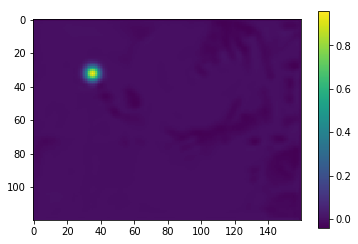

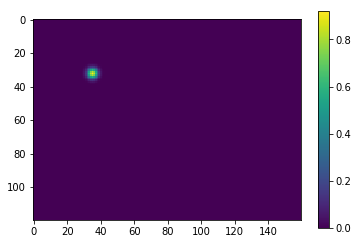

0.00162837328389287
tensor(0.5000, device='cuda:0')
4


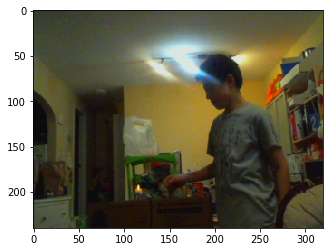

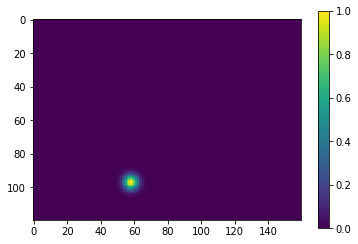

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


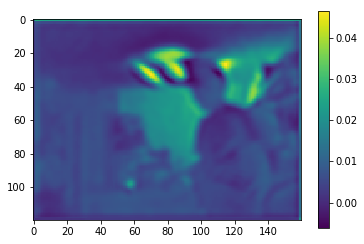

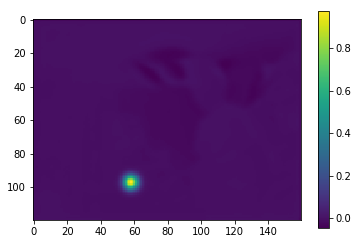

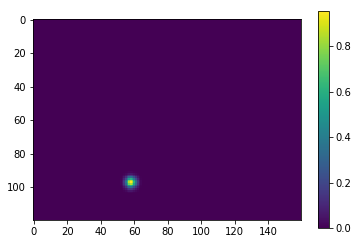

0.0016118050552904606
tensor(0.4922, device='cuda:0')
4


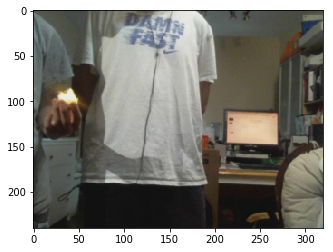

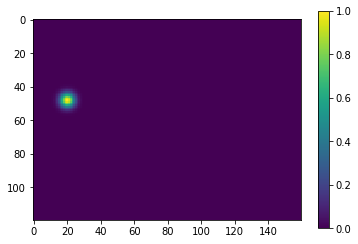

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


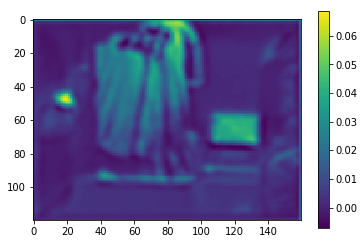

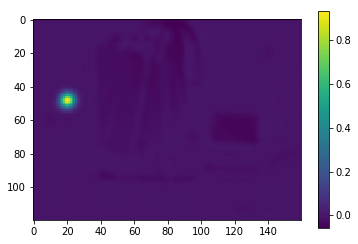

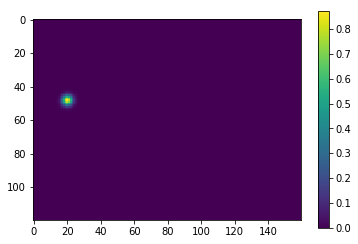

0.0015848068287596107
tensor(0.4686, device='cuda:0')
4


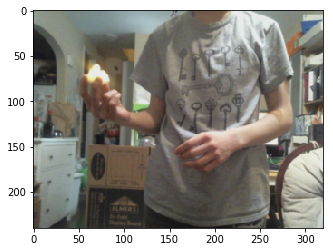

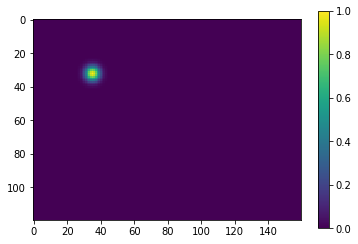

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


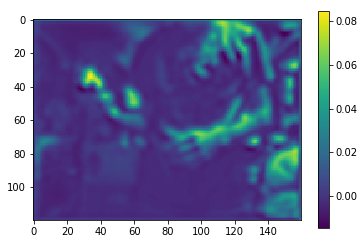

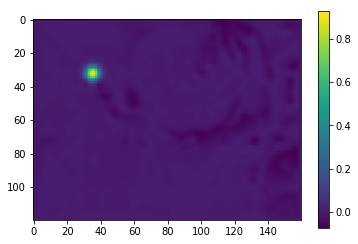

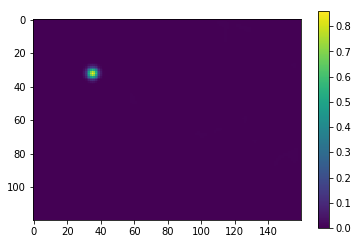

0.0015879175625741482
tensor(0.5000, device='cuda:0')
4


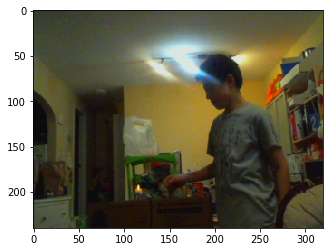

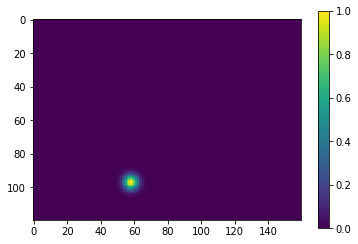

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


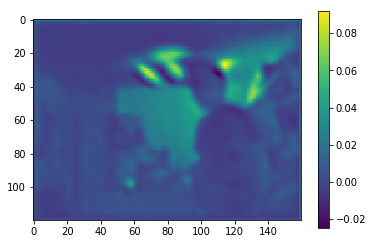

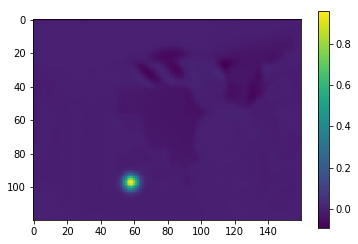

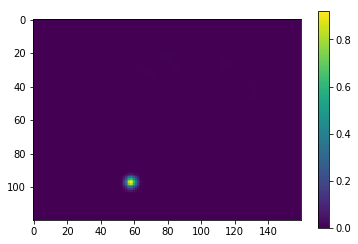

0.00155288923997432
tensor(0.4922, device='cuda:0')
4


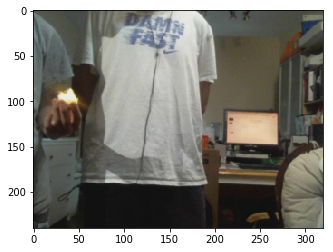

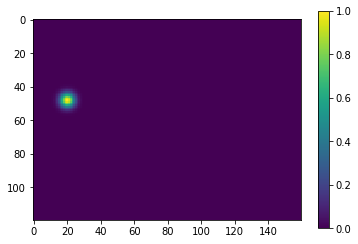

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


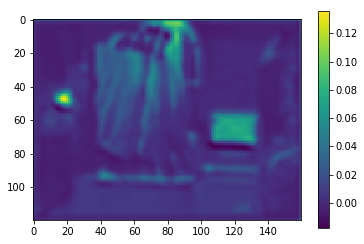

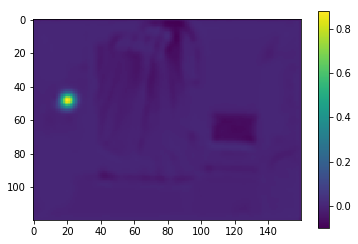

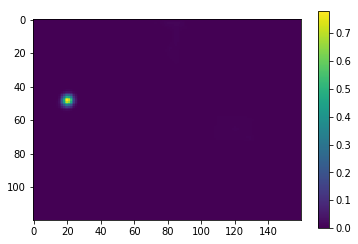

0.001518052420578897
tensor(0.4686, device='cuda:0')
4


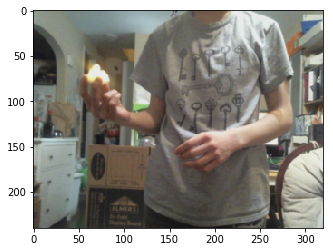

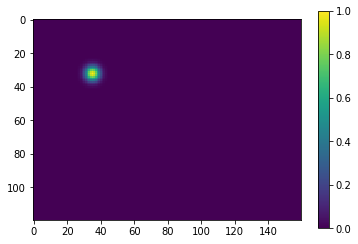

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


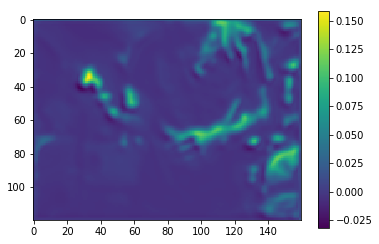

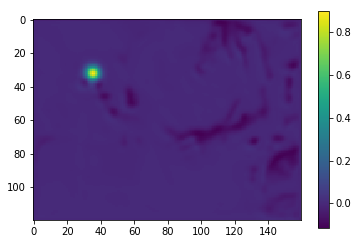

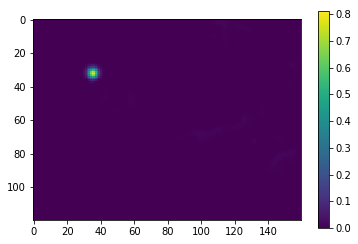

0.0015384567668661475
tensor(0.5000, device='cuda:0')
4


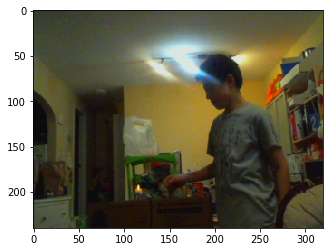

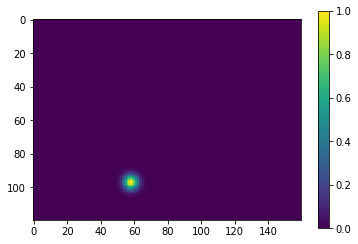

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


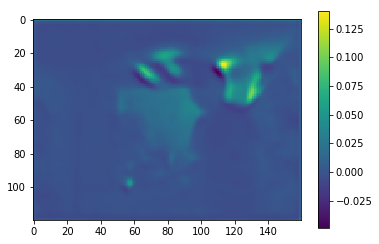

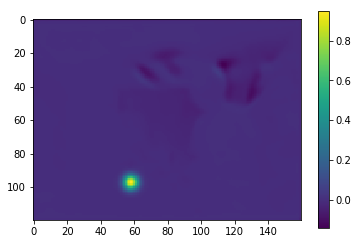

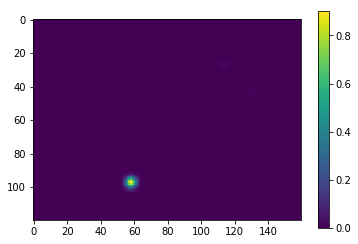

0.0014831222360953689
tensor(0.4922, device='cuda:0')
4


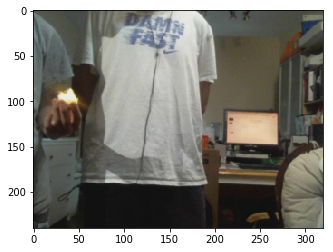

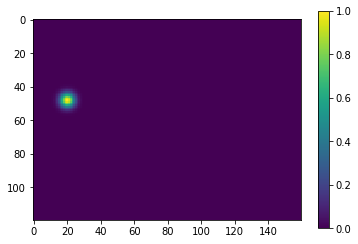

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


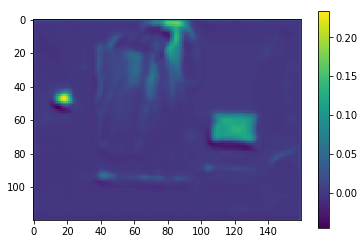

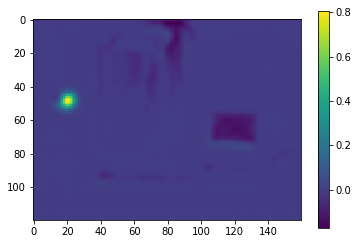

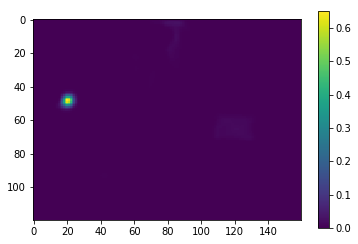

0.001412185374647379
tensor(0.4686, device='cuda:0')
4


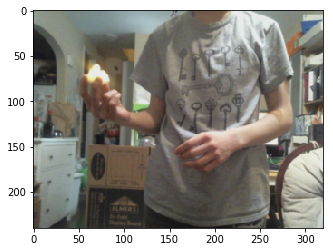

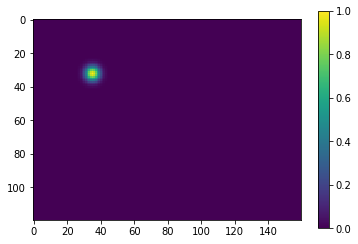

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


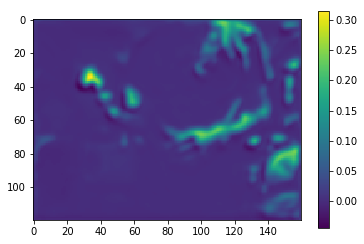

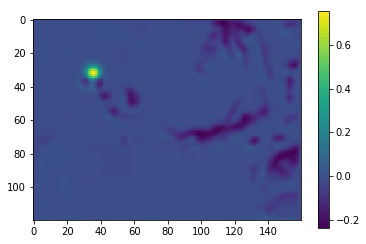

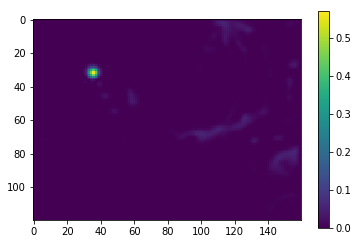

0.0016407713992521167
tensor(0.5000, device='cuda:0')
4


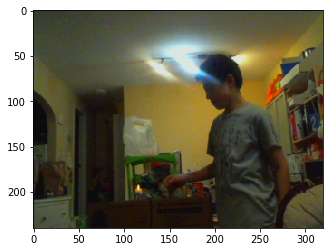

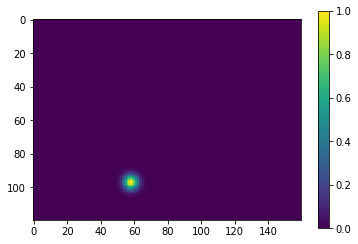

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


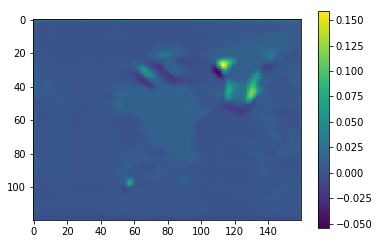

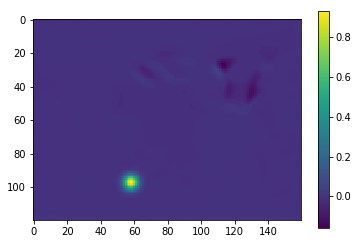

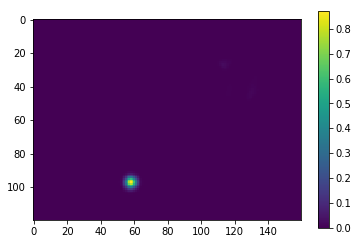

0.001449049566872418
tensor(0.4922, device='cuda:0')
4


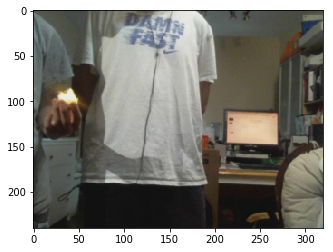

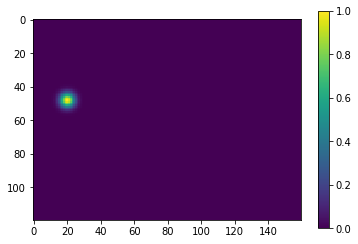

torch.Size([8, 120, 160])
torch.Size([8, 120, 160])


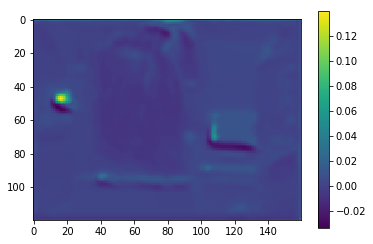

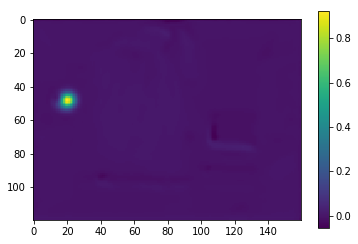

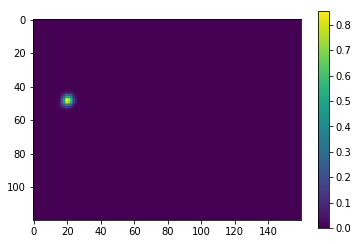

0.001512660295702517


In [12]:
from torch import FloatTensor 
from torch import optim
import random

cf_detector = CoarseFireDetector().cuda()

optimizer = optim.Adam(cf_detector.parameters(), lr = 0.001) 

n_epochs = 10 
batch_size = 8
for i in range(n_epochs):
    batch_img = []
    batch_label = []
    batch_weight = []
    
    #combined = list(zip(input_imgs, labels))
    #random.shuffle(combined)
    #input_imgs[:], labels[:] = zip(*combined)
    
    for j, (img, label) in enumerate(zip(input_imgs[:24], labels[:24])):
        batch_img.append(img.cuda()-0.5)
        batch_label.append(FloatTensor(label).cuda())
        #weights = np.zeros_like(label)
        weights = label+0.5
        #weights[label<0.001] = 1.0
        #weights[label>=0.001] = 10.0
        batch_weight.append(FloatTensor(weights).cuda())
        if len(batch_img) >= batch_size:
            optimizer.zero_grad()
            bimgs = torch.stack(batch_img)
            print(torch.max(bimgs))
            bweights = torch.stack(batch_weight)
            blabels = torch.stack(batch_label)
            out = cf_detector(bimgs).squeeze()
            show_torch_img(bimgs[0]+0.5)
            plt.show()
            plt.imshow(blabels[0].cpu().detach().numpy())
            plt.colorbar()
            plt.show()
            
            print(out.size())
            print(bweights.size())
            #loss = torch.mean(bweights*(blabels-out)**2)
            loss = torch.mean(bweights*(blabels-out)**2)
            plt.imshow((out)[0].cpu().detach().numpy())
            plt.colorbar()
            plt.show()
            plt.imshow((blabels-out)[0].cpu().detach().numpy())
            plt.colorbar()
            plt.show()
            plt.imshow(((blabels-out)**2)[0].cpu().detach().numpy())
            plt.colorbar()
            plt.show()
            #loss = torch.sum((FloatTensor(label).cuda()-out)**2)
            loss.backward()
            optimizer.step()
            batch_img = []
            batch_label = []
            batch_weight = []
            print(loss.item())
    
    

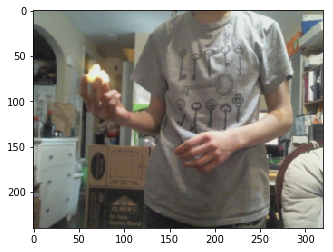

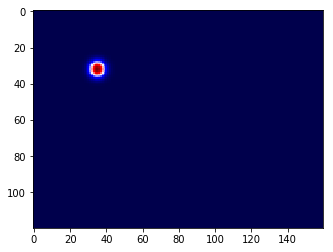

3


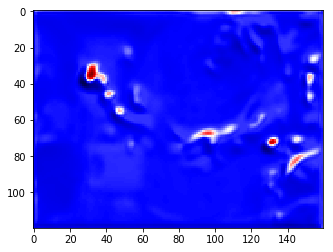

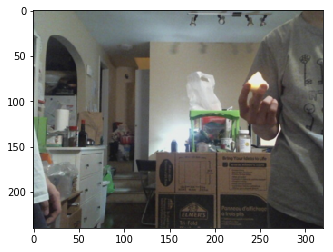

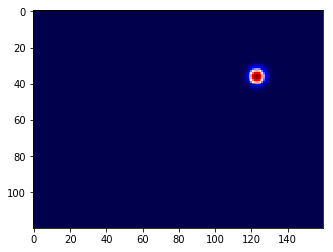

3


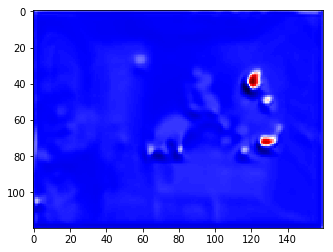

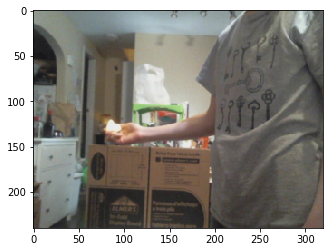

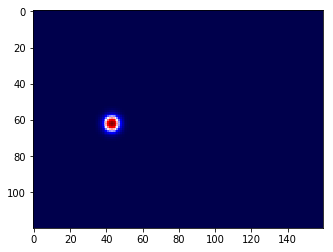

3


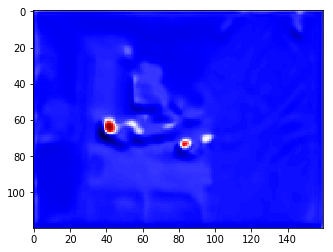

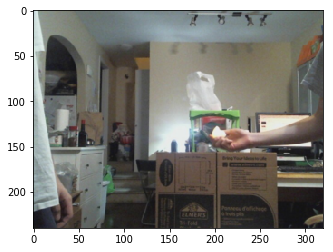

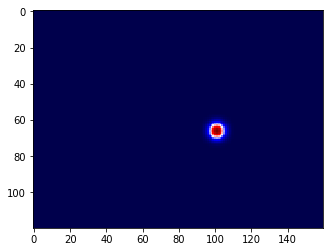

3


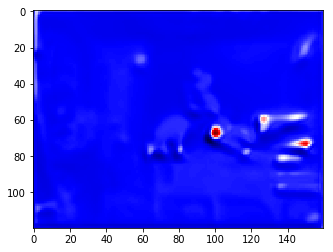

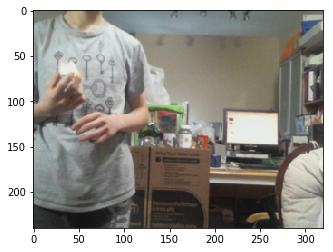

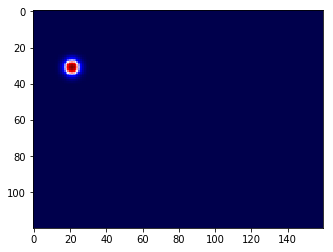

3


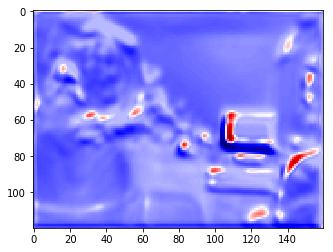

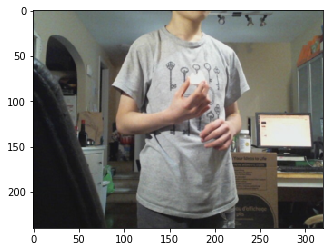

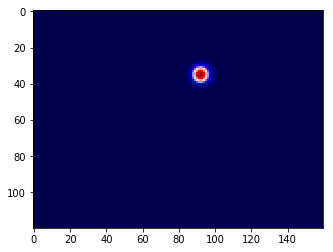

3


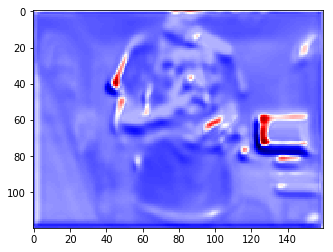

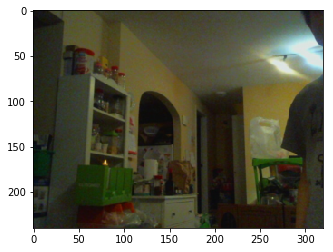

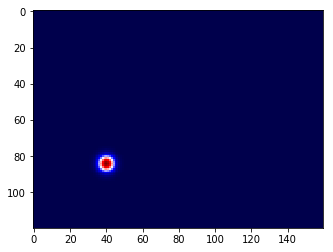

3


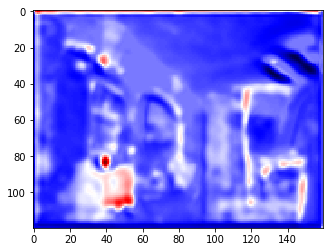

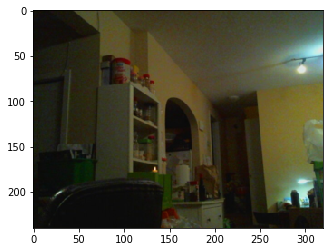

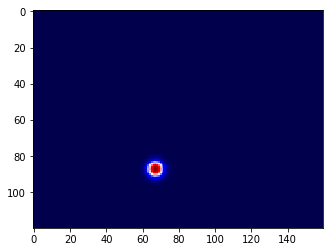

3


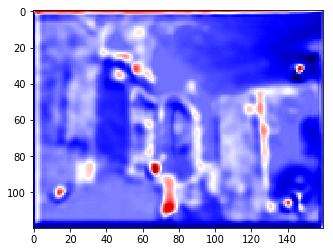

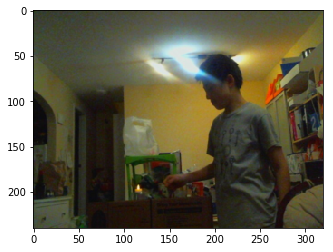

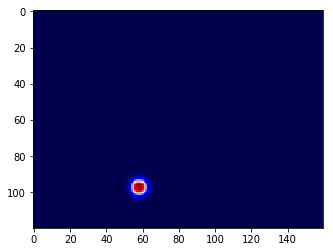

3


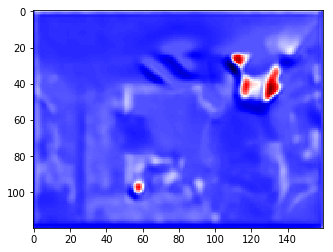

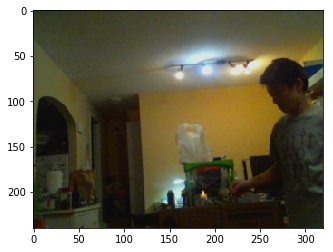

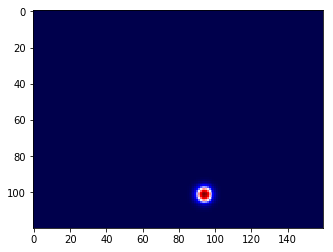

3


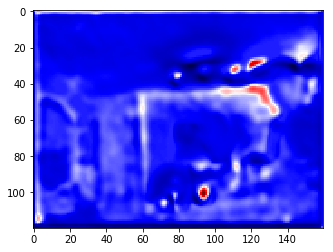

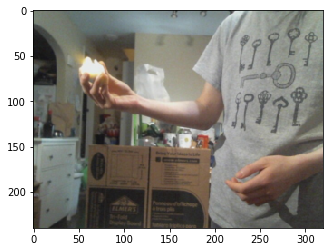

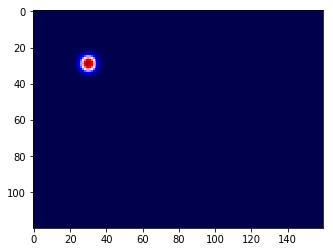

3


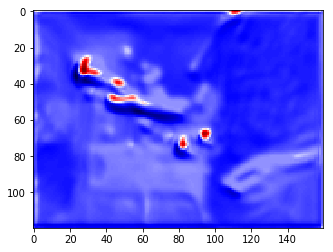

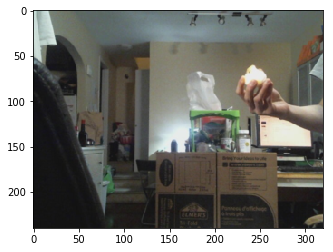

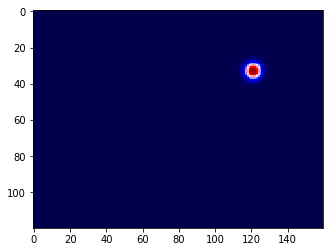

3


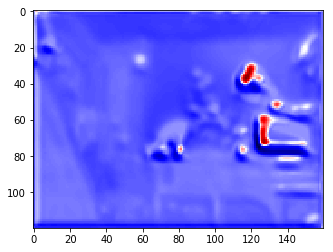

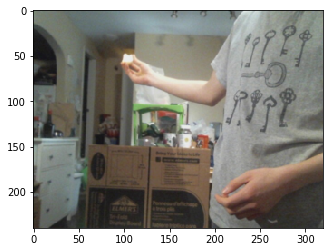

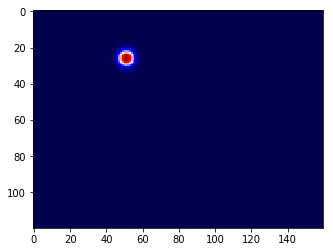

3


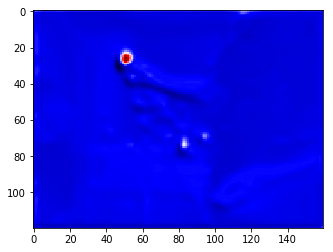

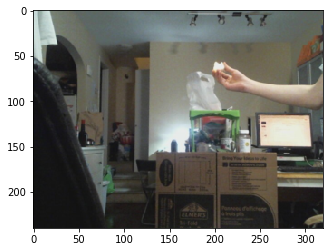

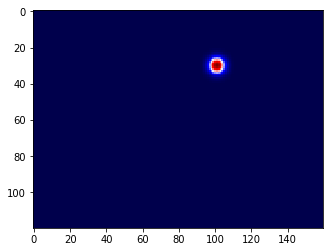

3


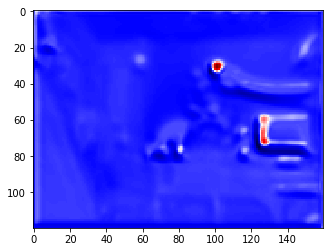

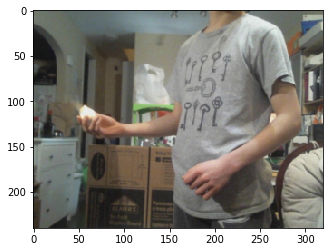

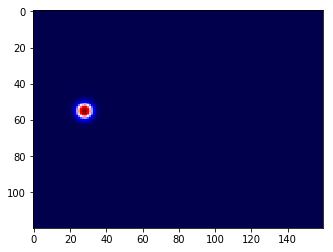

3


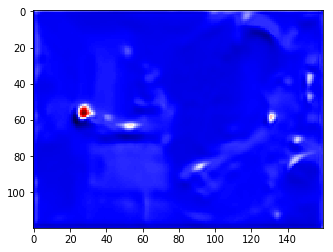

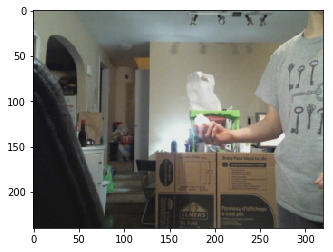

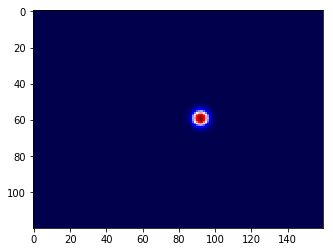

3


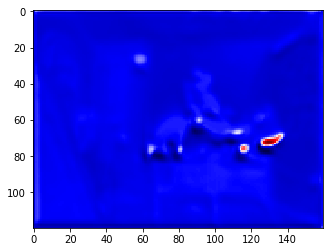

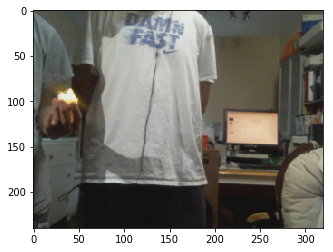

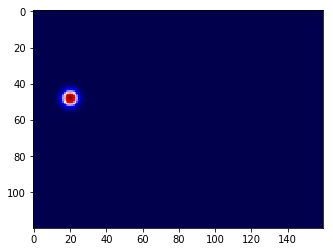

3


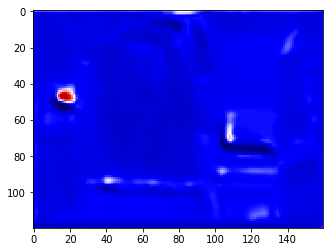

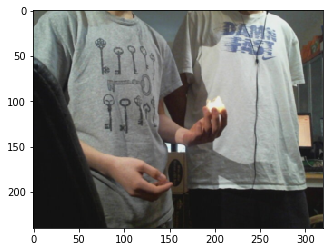

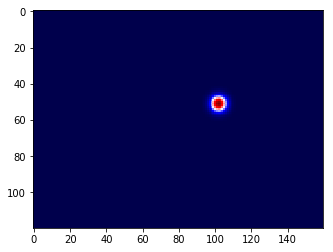

3


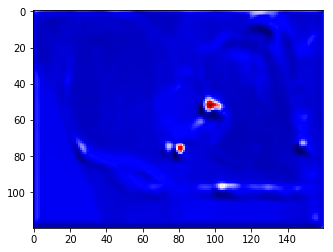

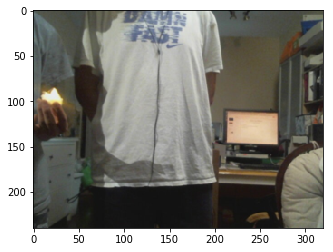

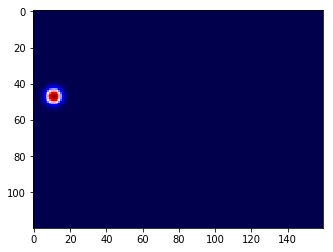

3


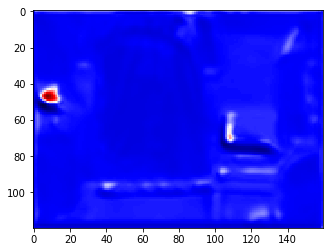

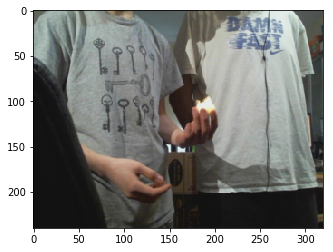

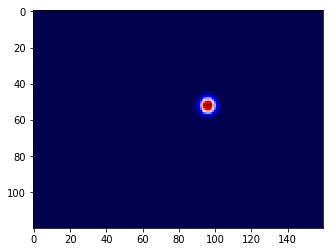

3


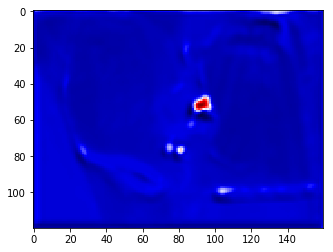

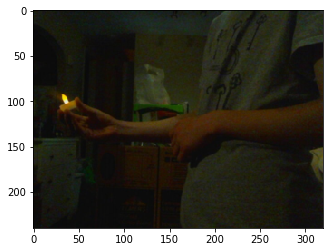

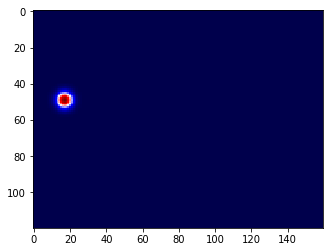

3


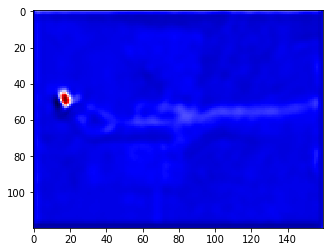

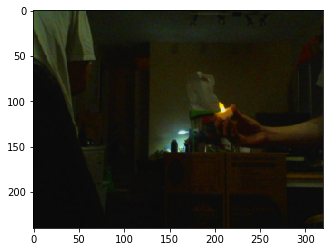

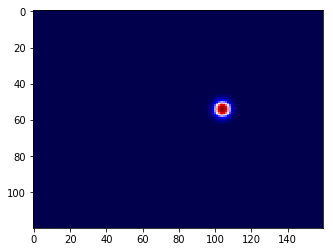

3


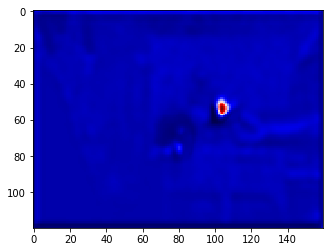

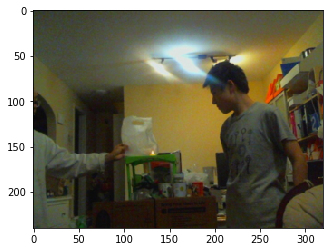

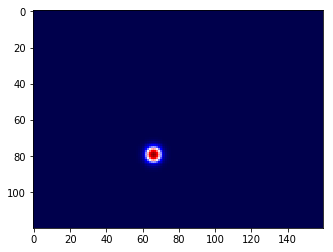

3


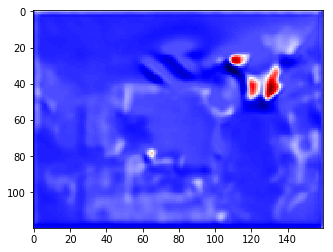

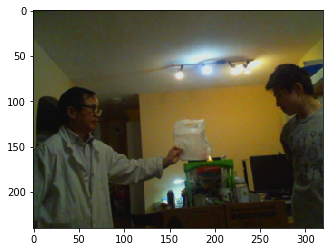

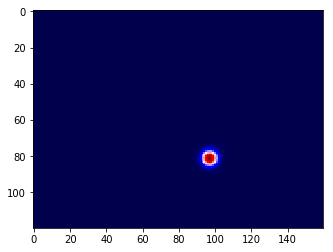

3


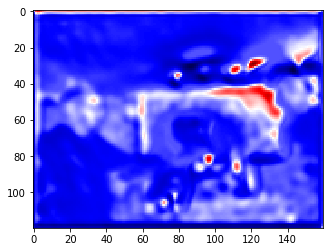

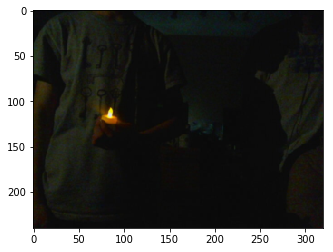

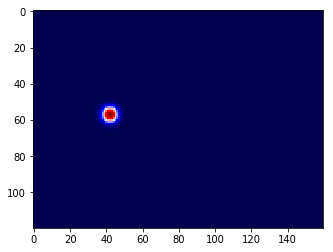

3


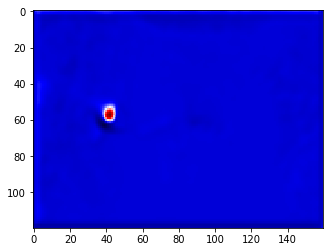

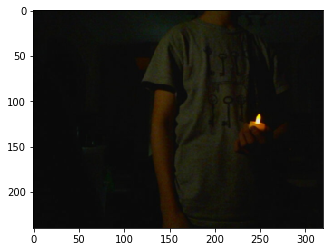

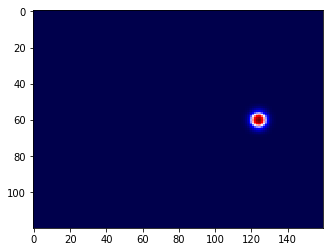

3


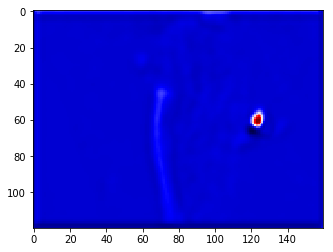

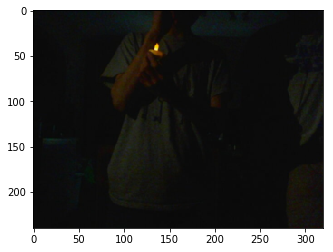

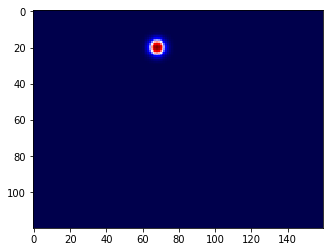

3


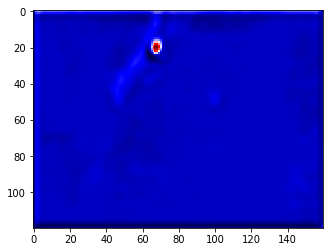

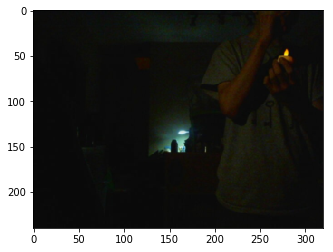

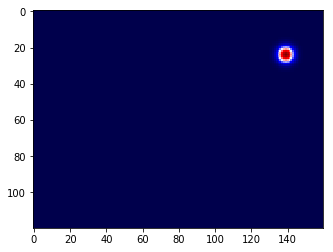

3


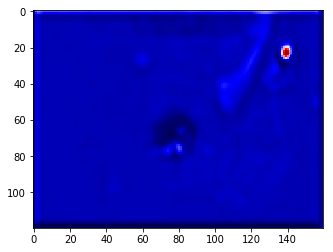

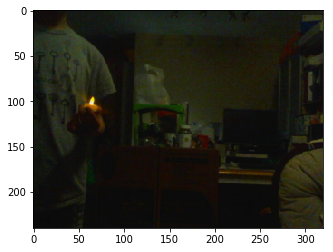

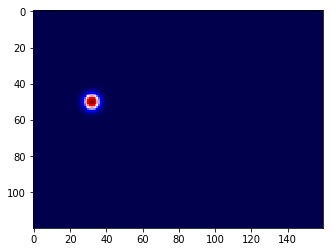

3


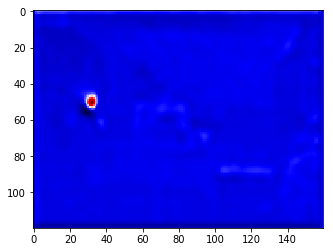

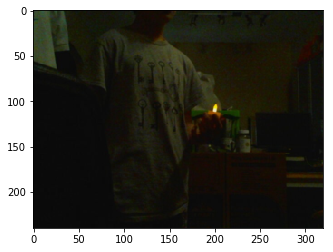

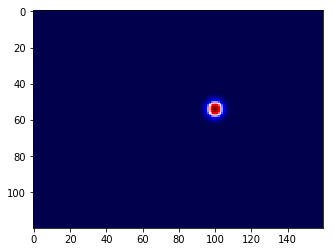

3


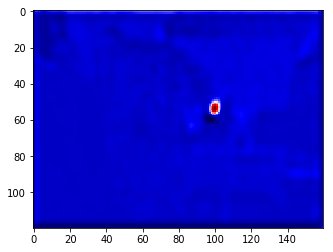

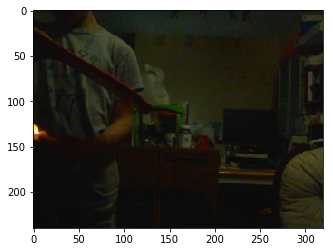

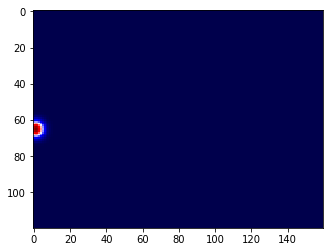

3


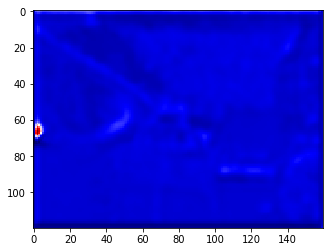

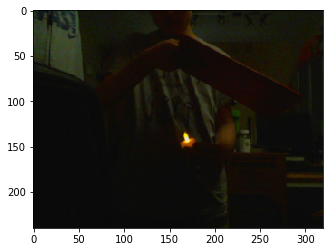

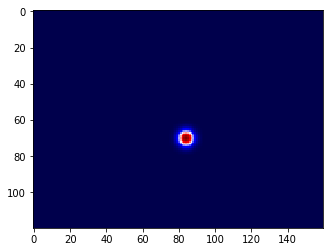

3


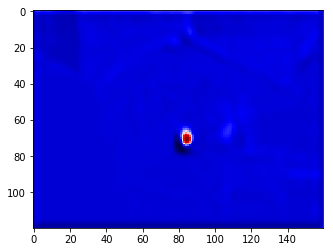

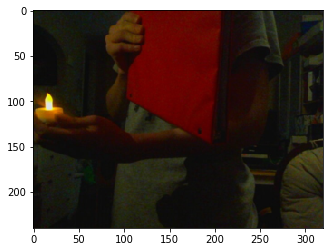

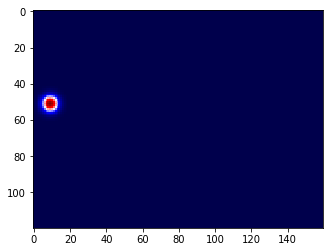

3


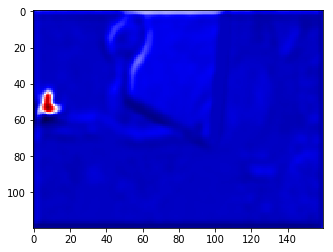

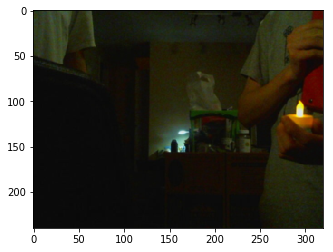

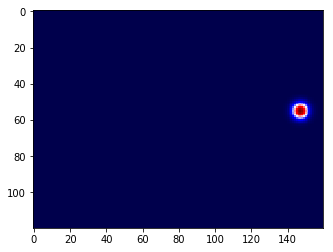

3


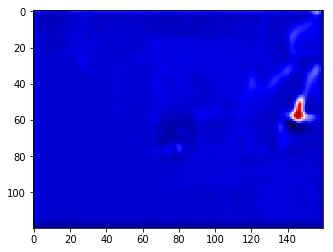

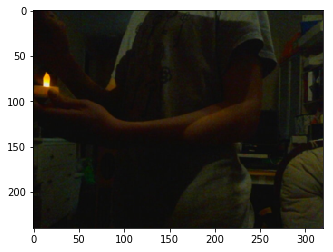

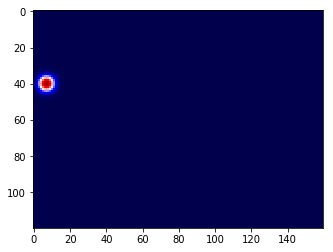

3


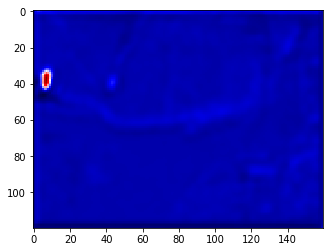

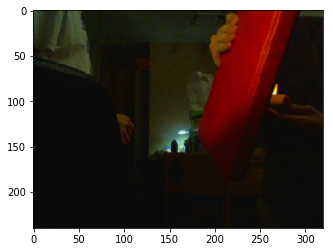

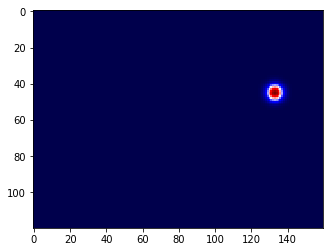

3


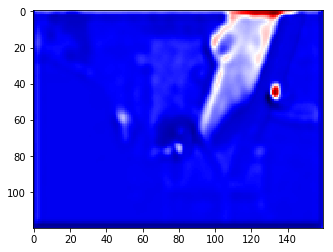

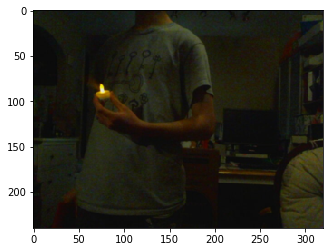

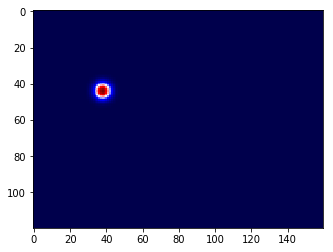

3


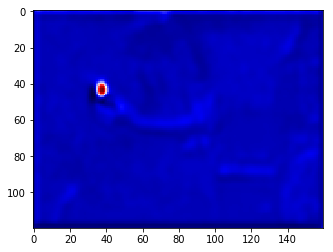

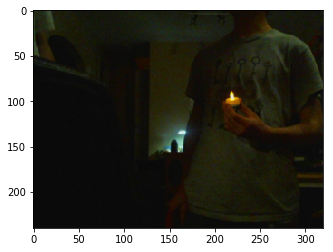

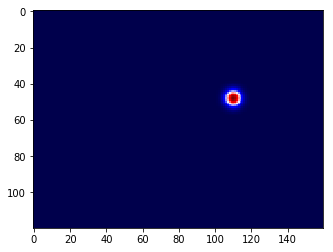

3


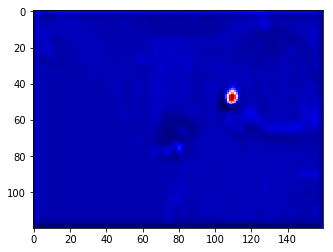

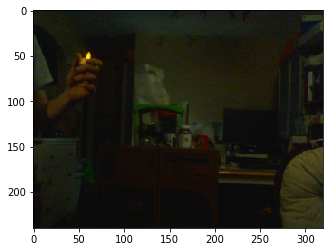

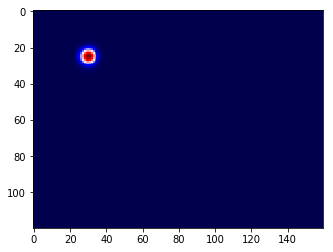

3


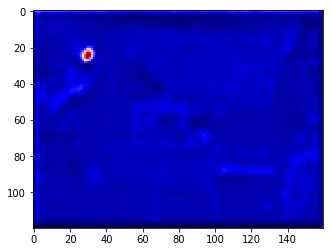

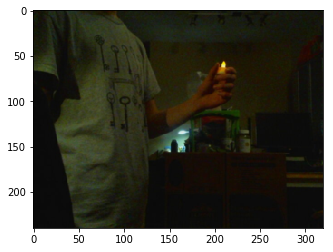

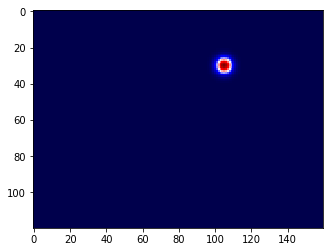

3


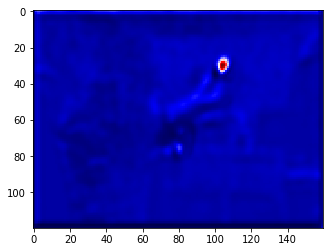

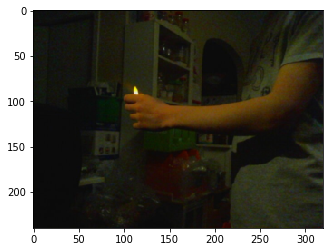

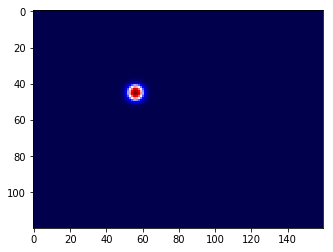

3


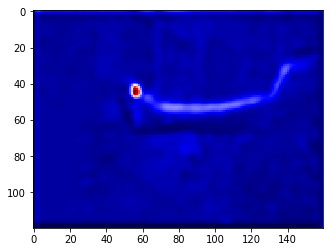

In [13]:
for j, (img, label) in enumerate(zip(input_imgs, labels)):
    if j>40:
        break
    show_torch_img(img)
    plt.show()
    plt.imshow(label, cmap = "seismic")
    plt.show()
    plt.imshow(cf_detector.cuda()(img.cuda()-0.5).cpu().detach().numpy(), cmap = "seismic")
    plt.show()